In [2]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from PIL import Image

In [73]:
cam_matrix = np.array([[525. ,   0. , 319.5],
       [  0. , 525. , 239.5],
       [  0. ,   0. ,   1. ]])
trans_depth_rgb = np.array([-0.025000000000000015, 0.0, 1.224020884649235e-13])
rot_depth_rgb = np.array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.]])

trans_baselink_rgb = np.array([-0.012499999999574012, 0.28700000000042597, 0.08699999999865589])
rot_baselink_rgb = np.array([[ 4.89630558e-12, -1.00000000e+00,  0.00000000e+00],
 [ 4.89641661e-12, -2.22044605e-16, -1.00000000e+00],
 [ 1.00000000e+00,  4.89641661e-12,  4.89630558e-12]])

rot_rgb_baselink = rot_baselink_rgb.T
trans_rgb_baselink = - rot_baselink_rgb.T @ trans_baselink_rgb

rot_depth_baselink = rot_rgb_baselink
trans_depth_baselink = rot_rgb_baselink @ trans_depth_rgb + trans_rgb_baselink

In [4]:
files = [f.replace('-points.npy', '') for f in glob.glob('*.npy')]

points = [np.load(f+'-points.npy') for f in files]
images = [cv2.imread(f+'.jpg') for f in files]
masks = [cv2.imread(f+'-masked.jpg') for f in files]

# Depth stuff


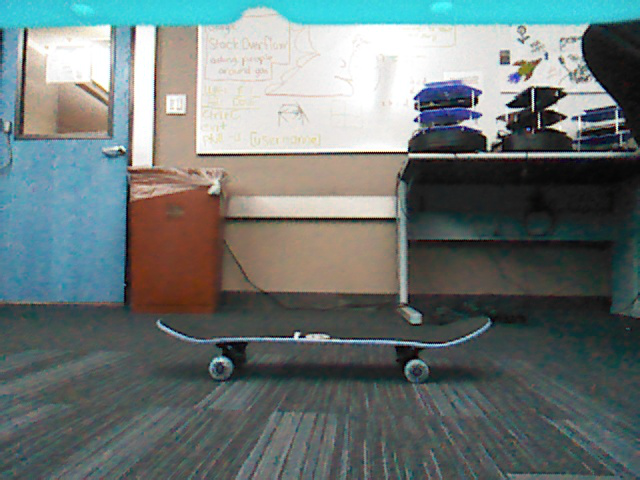
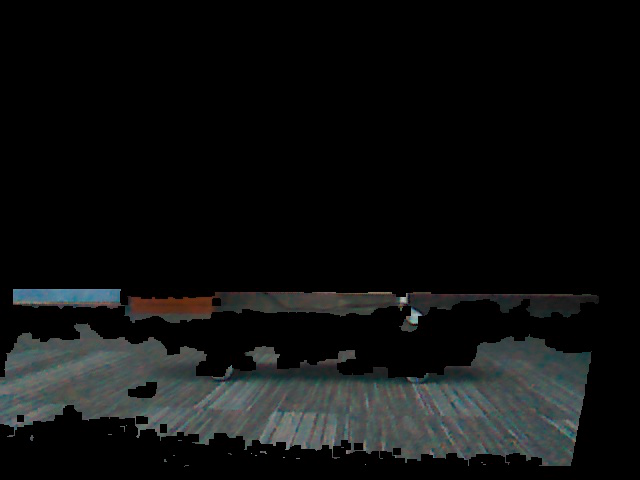

In [5]:
px.imshow(np.array([images[3], masks[3]]), facet_col=0)

In [6]:
pt = points[3]

fig = px.scatter_3d(x=pt[0], y=pt[1], z=pt[2])
fig.show()

In [7]:
transformed_pts = []
for p in pt.T:
    transformed_pts.append(rot_depth_baselink @ p + trans_depth_baselink)
transformed_pts = np.array(transformed_pts).T

fig = px.scatter_3d(x=transformed_pts[0], y=transformed_pts[1], z=transformed_pts[2])
fig.show()

In [8]:
def project_points(points, cam_matrix, trans, rot):
    points = np.dot(rot, points) + np.array(trans).reshape((3, 1))
    homo_pixel_coords = np.dot(cam_matrix, points)
    pixel_coords = homo_pixel_coords[0:2, :] / homo_pixel_coords[2, :]
    pixel_coords = np.floor(pixel_coords).astype('int32')
    return pixel_coords

pixel_coords = project_points(pt, cam_matrix, trans_depth_rgb, rot_depth_rgb)
px.scatter(x=pixel_coords[0], y=pixel_coords[1], color=pt[2])

# Image stuff


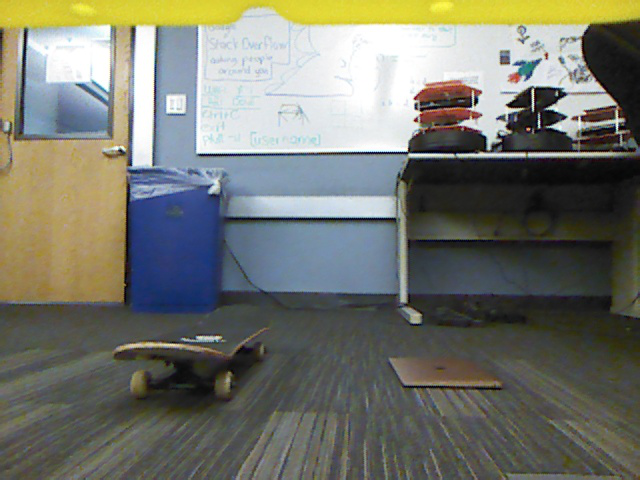

In [176]:
p_baselink = np.array([(x,y,0)
                           for x in np.arange(0, 3, 0.5)
                           for y in np.arange(-2, 3, 0.5) ]).T
texts = np.array([f'{x}, {y}' for x,y,z in p_baselink.T])

p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb.reshape((3, 1))
p_depth = p_rgb - trans_depth_rgb.reshape((3, 1))

p_images = project_points(p_depth, cam_matrix, trans_depth_rgb, rot_depth_rgb)
def is_valid(p_image):
    if p_image[0] < 0 or p_image[1] < 0 or p_image[0] > 640 or p_image[1] > 480:
        return False
    return True

valid = [is_valid(p) for p in p_images.T]
        
p_images = p_images[:, valid]
texts = texts[valid]

fig = px.scatter(x=p_images[0], y=p_images[1], text=texts)

fig.update_xaxes(range=[0, 640], showgrid=False)
fig.update_yaxes(range=[480, 0], showgrid=False)

fig.add_layout_image(
        dict(
            source=Image.open(files[2]+'.jpg'),
            xref="paper", yref="paper", x=0, y=1,
            xanchor="left", yanchor="top", layer="below",
            sizing="stretch", sizex=1.0, sizey=1.0,
            opacity=0.8)
)
fig.update_layout(template="plotly_dark")

fig.update_traces(textposition='top center')
fig.show()

In [42]:
rectangle = [[1.5, 0.5, 0], [1.5, 0, 0], [1, 0, 0], [1, 0.5, 0]]
dest = [[0,0], [100, 0], [100, 100], [0, 100]]

p_baselink = np.array(rectangle).T
p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb.reshape((3,1))
p_depth = p_rgb - trans_depth_rgb.reshape((3,1))

rect_image = project_points(p_depth, cam_matrix, trans_depth_rgb, rot_depth_rgb).T
dest = np.array(dest)


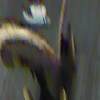

In [43]:
matrix, _ = cv2.findHomography(rect_image, dest)
warped = cv2.warpPerspective(images[2], matrix, (100, 100))
px.imshow(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))

[[-1.19833019e-01 -4.22755824e-01  1.39536665e+02]
 [ 4.72632331e-17 -1.08016724e+00  3.21612378e+02]
 [ 3.50128369e-19 -4.17536580e-03  1.00000000e+00]]



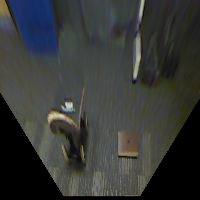

In [118]:
def project_points_float(points, cam_matrix, trans, rot):
    points = np.dot(rot, points) + np.array(trans).reshape((3, 1))
    homo_pixel_coords = np.dot(cam_matrix, points)
    pixel_coords = homo_pixel_coords[0:2, :] / homo_pixel_coords[2, :]
    return pixel_coords.astype(np.float32)

DEPTH_MAX = 2.5
DEPTH_MIN = 0.5

RANGE = 1.0

rectangle = [[DEPTH_MAX, RANGE,0], [DEPTH_MAX, -RANGE,0], [DEPTH_MIN, -RANGE,0], [DEPTH_MIN, RANGE,0]]

W = 200
H = 200
dest = [[0,0], [W, 0], [W, H], [0, H]]

p_baselink = np.array(rectangle).T
p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb.reshape((3,1))
p_depth = p_rgb - trans_depth_rgb.reshape((3,1))

rect_image = project_points_float(p_depth, cam_matrix, trans_depth_rgb, rot_depth_rgb).T
dest = np.array(dest).astype(np.float32)

matrix = cv2.getPerspectiveTransform(rect_image, dest)
print(matrix)
warped = cv2.warpPerspective(images[2], matrix, (W, H))
warped_img = cv2.cvtColor(warped, cv2.COLOR_BGR2RGB)

px.imshow(warped_img)


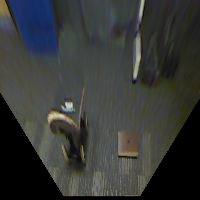

In [119]:
p_baselink = np.array([(x,y,0)
                           for x in np.arange(0, 3, 0.5)
                           for y in np.arange(-2, 3, 0.5) ]).T
texts = np.array([f'{x}, {y}' for x,y,z in p_baselink.T])

p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb.reshape((3, 1))
p_depth = p_rgb - trans_depth_rgb.reshape((3, 1))

p_images = project_points_float(p_depth, cam_matrix, trans_depth_rgb, rot_depth_rgb)
p_images = cv2.perspectiveTransform(np.expand_dims(p_images.T, 0), matrix)[0]

fig = px.scatter(x=p_images[:,0], y=p_images[:,1], text=texts)
fig.update_traces(textposition='top center')

fig.update_xaxes(range=[0, W], showgrid=False)
fig.update_yaxes(range=[H, 0], showgrid=False)
fig.update_layout(template="plotly_dark")

fig.add_traces(px.imshow(warped_img).data[0])

fig.show()

# Play with world coordinate translation

Rotate the robot a little!

In [250]:
# Rotate 10 degrees in z axis
rot_world_base, _ = cv2.Rodrigues(10 * np.pi/180 * np.array([0,0,1]))
# No translation
trans_world_base = np.array([0, 0.5, 0])

rot_base_world = rot_world_base.T
trans_base_world = - rot_world_base.T @ trans_world_base

base_matrix = matrix


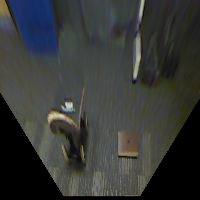

In [121]:
p_world = np.array([(x,y,0)
                           for x in np.arange(0, 3, 0.5)
                           for y in np.arange(-2, 3, 0.5) ]).T
texts = np.array([f'{x}, {y}' for x,y,z in p_world.T])

p_baselink = rot_world_base @ p_world + trans_world_base.reshape((3,1))
p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb.reshape((3, 1))
p_depth = p_rgb - trans_depth_rgb.reshape((3, 1))

p_images = project_points_float(p_depth, cam_matrix, trans_depth_rgb, rot_depth_rgb)
p_images = cv2.perspectiveTransform(np.expand_dims(p_images.T, 0), matrix)[0]

fig = px.scatter(x=p_images[:,0], y=p_images[:,1], text=texts)
fig.update_traces(textposition='top center')
fig.add_traces(px.imshow(warped_img).data[0])

fig.update_xaxes(range=[0, W], showgrid=False)
fig.update_yaxes(range=[H, 0], showgrid=False)
fig.update_layout(template="plotly_dark")
fig.show()

## Robust method: recompute homography


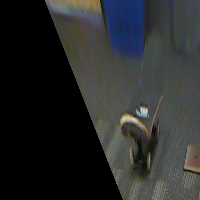

In [163]:
def composeRT(Rs, ts):
    R, t = Rs[0], ts[0]
    for (R2, t2) in zip(Rs[1:], ts[1:]):
        t = R2 @ t + t2
        R = R2 @ R
    return R, t

r_world_depth, t_world_depth = composeRT(
    (rot_world_base, rot_baselink_rgb, np.eye(3)),
    (trans_world_base, trans_baselink_rgb, -trans_depth_rgb)
)

p_depth = r_world_depth @ np.array(rectangle).T + t_world_depth.reshape((3,1))

rect_image = project_points_float(p_depth, cam_matrix, trans_depth_rgb, rot_depth_rgb).T
dest = np.array(dest).astype(np.float32)

matrix = cv2.getPerspectiveTransform(rect_image, dest)
warped = cv2.warpPerspective(images[2], matrix, (W, H))
warped_img = cv2.cvtColor(warped, cv2.COLOR_BGR2RGB)

def plot_warped(warped_img, matrix):
    p_world = np.array([(x,y,0)
                               for x in np.arange(0, 3, 0.5)
                               for y in np.arange(-2, 3, 0.5) ]).T
    texts = np.array([f'{x}, {y}' for x,y,z in p_world.T])

    p_baselink = rot_world_base @ p_world + trans_world_base.reshape((3,1))
    p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb.reshape((3, 1))
    p_depth = p_rgb - trans_depth_rgb.reshape((3, 1))

    p_images = project_points_float(p_depth, cam_matrix, trans_depth_rgb, rot_depth_rgb)
    p_images = cv2.perspectiveTransform(np.expand_dims(p_images.T, 0), matrix)[0]

    fig = px.scatter(x=p_images[:,0], y=p_images[:,1], text=texts)
    fig.update_traces(textposition='top center')
    fig.add_traces(px.imshow(warped_img).data[0])

    fig.update_xaxes(range=[0, W], showgrid=False)
    fig.update_yaxes(range=[H, 0], showgrid=False)
    fig.update_layout(template="plotly_dark")
    fig.show()

plot_warped(warped_img, matrix)

## Faster method: Multiply base matrix

[[-1.19833019e-01 -4.22755824e-01  1.39536665e+02]
 [ 4.72632331e-17 -1.08016724e+00  3.21612378e+02]
 [ 3.50128369e-19 -4.17536580e-03  1.00000000e+00]]



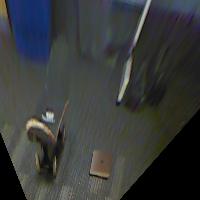

In [161]:
print(base_matrix)
matrix = rot_world_base @ base_matrix

warped = cv2.warpPerspective(images[2], matrix, (W, H))
warped_img = cv2.cvtColor(warped, cv2.COLOR_BGR2RGB)
plot_warped(warped_img, matrix)

Conclusion: This is tricky

## Finding a good rectangle

### Find some corners to use


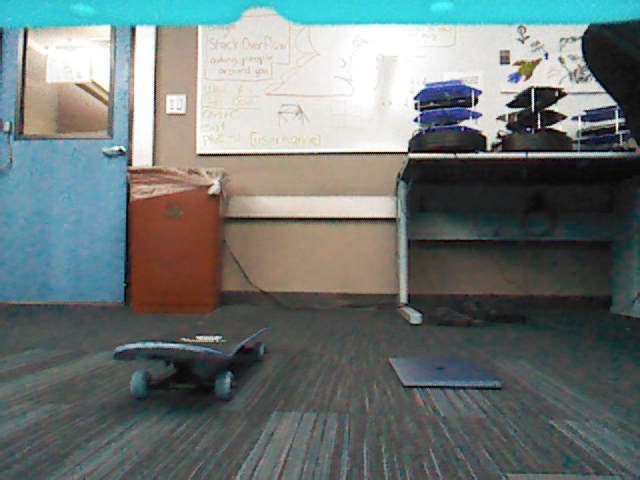

[[ 2.5    1.562  0.   ]
 [ 2.5   -1.592  0.   ]
 [ 0.54  -0.395  0.   ]
 [ 0.54   0.369  0.   ]]


In [248]:
DEPTH_MAX = 2.5

r_base_depth, t_base_depth = composeRT(
    (rot_baselink_rgb, np.eye(3)),
    (trans_baselink_rgb, -trans_depth_rgb)
)

def project(points):
    p_depth = r_base_depth @ np.array(points).T + t_base_depth.reshape((3,1))
    p_images = project_points_float(p_depth, cam_matrix, trans_depth_rgb, rot_depth_rgb)
    return p_images

y = 0
while project([[DEPTH_MAX, y, 0]])[0,0] > 0:
    y += 0.001
Y_MIN = round(y, 3)
    
y = 0
while project([[DEPTH_MAX, y, 0]])[0,0] < 640:
    y -= 0.001
Y_MAX = round(y, 3)

tests = np.array([(x, y, 0)
                  for x in np.arange(0, DEPTH_MAX, 0.001)
                  for y in np.arange(Y_MAX, Y_MIN, 0.001)
                 ])
proj = project(tests).T

x_diff = np.sum((proj - [0, 480])**2, axis=1)
X_MIN = tests[np.argmin(x_diff)]

x_diff = np.sum((proj - [640, 480])**2, axis=1)
X_MAX = tests[np.argmin(x_diff)]

points = np.array([
    [DEPTH_MAX, Y_MIN, 0], [DEPTH_MAX, Y_MAX, 0],
    X_MAX, X_MIN
])

p_images = project(points)

fig = px.scatter(x=p_images[0], y=p_images[1])
fig.add_traces(px.imshow(images[2]).data[0])

fig.update_layout(template="plotly_dark")
fig.show()

print(points)

### Project these corners into world space 


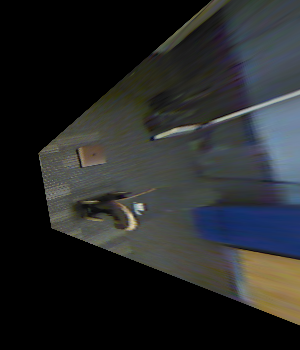

In [290]:
VOXEL_SIZE = 0.5
PIXELS_PER_VOXEL = 50

points_t = rot_base_world @ points.T + trans_base_world.reshape((3,1))
x_min = np.floor(np.min(points_t[0]) / VOXEL_SIZE) * VOXEL_SIZE
x_max = np.ceil(np.max(points_t[0]) / VOXEL_SIZE) * VOXEL_SIZE
y_min = np.floor(np.min(points_t[1]) / VOXEL_SIZE) * VOXEL_SIZE
y_max = np.ceil(np.max(points_t[1]) / VOXEL_SIZE) * VOXEL_SIZE

voxels_x = int(round((x_max - x_min) / VOXEL_SIZE))
voxels_y = int(round((y_max - y_min) / VOXEL_SIZE))

W = voxels_x * PIXELS_PER_VOXEL
H = voxels_y * PIXELS_PER_VOXEL

rectangle = np.array([
    [x_min, y_min, 0], [x_min, y_max, 0],
    [x_max, y_max, 0], [x_max, y_min, 0],
])
dest = [[0,0], [0, H], [W, H], [W, 0]]
p_depth = r_world_depth @ np.array(rectangle).T + t_world_depth.reshape((3,1))

rect_image = project_points_float(p_depth, cam_matrix, trans_depth_rgb, rot_depth_rgb).T
dest = np.array(dest).astype(np.float32)

mask_like_img = np.ones(images[2].shape[:2], dtype=np.uint8)

matrix = cv2.getPerspectiveTransform(rect_image, dest)
warped = cv2.warpPerspective(images[2], matrix, (W, H))
mask = cv2.warpPerspective(mask_like_img, matrix, (W, H))
warped_img = cv2.cvtColor(warped, cv2.COLOR_BGR2RGB)
plot_warped(warped_img, matrix)


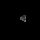

In [308]:
GRID_X_MIN = -10
GRID_Y_MIN = -10
GRID_X_MAX = 10
GRID_Y_MAX = 10

g_w = int(round((GRID_X_MAX - GRID_X_MIN)/VOXEL_SIZE))
g_h = int(round((GRID_Y_MAX - GRID_Y_MIN)/VOXEL_SIZE))
grid = np.zeros((g_h, g_w, 3))

PPV = PIXELS_PER_VOXEL

for x in range(0, voxels_x):
    for y in range(0, voxels_y):
        gx = x + int(round((x_min - GRID_X_MIN)/VOXEL_SIZE))
        gy = y + int(round((y_min - GRID_Y_MIN)/VOXEL_SIZE))
        
        img = warped_img[ y*PPV:(y+1)*PPV, x*PPV:(x+1)*PPV ]
        m = mask[ y*PPV:(y+1)*PPV, x*PPV:(x+1)*PPV ]
        n = np.sum(m)
        
        if n > 0:
            average = img.sum(axis=(0,1)) / n
            grid[gy, gx] = average
        
px.imshow(grid)